In [98]:
import sys
import os

sys.path.append('~/Project/source/')

from sus.library.potentials import blw, odv, duffing_2D
from sus.protocol_designer import System, Protocol, Potential, Compound_Protocol

import numpy as np 

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams["animation.html"] = "jshtml"
from IPython.display import HTML


In [99]:
# If we want to actually calculate values of the potential and force, we need to put in 
# some coordinates.

# N sets of coordinates are expected to be in an array with shape (N,D,2)
# where D is the dimensionality of our system, the length 2 dimension determines 
# position/velocity coordinates

N=20
coords_2D=np.random.random_sample((N,2,2))
coords_1D=np.random.random_sample((N,1,2))
coords_5D=np.random.random_sample((10,5,2))
#these will be used later

# Protocols

In [100]:
len(coords_5D)

10

In [101]:
#Let's jump in by importing some example protocols, we can talk about making them (and 
# potentials) later.

# example_substages defines 4 simple substages (intances of the protocol class):
#    ESS.tilt, ESS.untilt, ESS.lower, ESS.unlower

# also defined is the protocol you get by combining the four substages into a single 
# protocol:
#    ESS.CP (this is an instance of the compound protocol class, which is what most 
#    interesting protocols will be)


import sus.library.example_substages as ESS

erase_prot=ESS.CP

tilt=ESS.tilt
untilt=ESS.untilt
lower=ESS.lower
unlower=ESS.unlower

# all that protocols do is store some number of parameters as a function of time. 
# They are very simple objects.
# each of the protocols above are 12 parameter protocols,

In [102]:
ESS.CP?

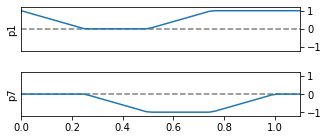

(<Figure size 360x144 with 2 Axes>,
 array([<AxesSubplot:ylabel='p1'>, <AxesSubplot:ylabel='p7'>], dtype=object))

In [103]:
# we can look at the signal a compound protocol generates over time:
"""What's the meaning of these parameters?"""
erase_prot.show_params()

In [104]:
erase_prot.show_params?

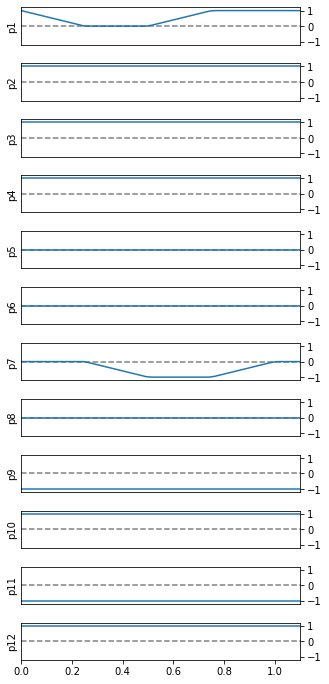

(<Figure size 360x864 with 12 Axes>,
 array([<AxesSubplot:ylabel='p1'>, <AxesSubplot:ylabel='p2'>,
        <AxesSubplot:ylabel='p3'>, <AxesSubplot:ylabel='p4'>,
        <AxesSubplot:ylabel='p5'>, <AxesSubplot:ylabel='p6'>,
        <AxesSubplot:ylabel='p7'>, <AxesSubplot:ylabel='p8'>,
        <AxesSubplot:ylabel='p9'>, <AxesSubplot:ylabel='p10'>,
        <AxesSubplot:ylabel='p11'>, <AxesSubplot:ylabel='p12'>],
       dtype=object))

In [105]:
# by default it only shows the nontrivial parameters (the ones that are not constant)
# we can show all by using
erase_prot.show_params(which='all')

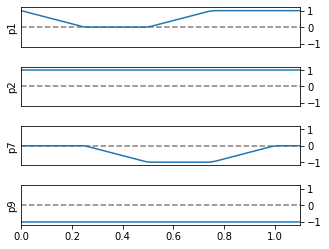

(<Figure size 360x288 with 4 Axes>,
 array([<AxesSubplot:ylabel='p1'>, <AxesSubplot:ylabel='p2'>,
        <AxesSubplot:ylabel='p7'>, <AxesSubplot:ylabel='p9'>], dtype=object))

In [106]:
# this protocol has 12 parameters, but most of them are trivial
# you could also show any subset of parameters by specifying an explicit "which":
erase_prot.show_params(which=[1,2,7,9])

In [107]:
#A compound protocol can give you the substage times
#if you want an array of the times:
"""
These are the time for the four stage? 
i.e. tilt, untilt, lower and unlower
"""
print(erase_prot.times)

[[0.   0.25]
 [0.25 0.5 ]
 [0.5  0.75]
 [0.75 1.  ]]


In [108]:
# if you want just the initial and final time of the whole protocol:
print('initial time:',erase_prot.t_i)
print('final time:',erase_prot.t_f)

initial time: 0.0
final time: 1.0


In [109]:
#if you just want a printout that tells you what each time corresponds to:
erase_prot.show_substage_times()

stage 1 times: [0.   0.25]
stage 2 times: [0.25 0.5 ]
stage 3 times: [0.5  0.75]
stage 4 times: [0.75 1.  ]


In [110]:
#For a simple protocol, there are no substages:

#if we look at the protocol that is just one of the substages (called 'tilt') we can still use
#Protocol.t_i and Protocol.t_f to give initial and final times of the protocol:
print('initial time is:',tilt.t_i)
print('final time is:',tilt.t_f)

initial time is: 0.25
final time is: 0.5


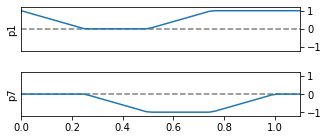

(<Figure size 360x144 with 2 Axes>,
 array([<AxesSubplot:ylabel='p1'>, <AxesSubplot:ylabel='p7'>], dtype=object))

In [111]:
# we have different interpolation methods as well, here is a plot of the nontrivial parameters in this 
# erase protocol
# note that the interpolation from one substage to another is linear:
erase_prot.show_params()

In [112]:
# Compound_Protocol.protocols gives a list of all the substage protocols that make up the compound one.
# here we see the first substage uses a linear interpolation:
erase_prot.protocols[0].interpolation


'linear'

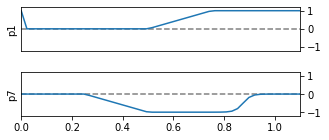

(<Figure size 360x144 with 2 Axes>,
 array([<AxesSubplot:ylabel='p1'>, <AxesSubplot:ylabel='p7'>], dtype=object))

In [113]:
# but, we can change the interpolation as follows. currently there are two other modes 'step' and 'sigmoid'
erase_prot.protocols[0].interpolation = 'step'
erase_prot.protocols[3].interpolation = 'sigmoid'
erase_prot.show_params()

# Applying Protocols to Potentials using a System

In [114]:
# Next we have the System class. It interpolates between whatever protocol/potential you create
# and gregs simulation architecture. also contains visualization methods and other tools

# Now we create the system that the protocol will apply to
# Systems take an instance of the protocol class as an input, as well as an instance of the  potential class.
# we can talk about building potentials later, for now well use a predefined one:
#ODV is a predefined potential, so lets just plop it in:

erase_sys=System(erase_prot,odv)


AssertionError: the number of protocol parameters must match the potential

### Oh no! An error. 
###### This is actually to be expected because the potential we put in needs 2 parameters to be defined but the protocol actually defined 12 different things. Thus, the assert error we get

In [115]:
len(erase_prot.params)

12

In [116]:
#When you define a system it will check if the protocol is compatilbe with the potential.

#you can check information on a potential object:
"""What is the meaning of current scale?

"""
odv.info()


This potential has 2 parameters and 1 dimensions
The current scale is 1
To see details about the specific potential set verbose=True


In [117]:
duffing_2D.info(verbose=True)


    the coupled 2D duffing potential:
    defautls are set so that it is 4 equal wells

    Parameters
    ----------
    x: ndarray of dimension [N,]
        the x coordinates for N positions
    y: ndarray of dimension [N,]
        the y coordinates for N positions
    params: list/tuple (1, 2, 3, 4, 5, 6, 7)
        1, 2 : coefficients of the x^4 and y^4 terms, respectively
        3, 4 : coefficients of the x^2 and y^2 terms, respectively
        5, 6 : coefficients of the x^1 and y^1 terms, respectively
        7: coefficient of the coupling term, x*y

    Returns
    -------
    the value of the potential at locations x,y with the given params
    


In [118]:
# setting verbose =True will give you the docstring for the functional form of the potential
odv.info(verbose=True)


    A simple 1D potential, for testing one dimensional systems
    its just an absolute value.

    Parameters
    ----------
    x: the coordinates
    params: (1,2)
        1: the slope
        2: zero point

    Returns
    -------
    the value of the potential at location x with the given params
    


In [119]:
#BLW is a predefined 2D potential (happens to be a 4 well system).
# it takes 12 parameters, and our erase protocol is a 12 parameter protocol,
# so this will work with the erasing protocol. technically any 12 parameter potential would be compatible though.
blw.info()



This potential has 12 parameters and 2 dimensions
The current scale is 1
To see details about the specific potential set verbose=True


In [120]:
#initialize our full system:
# There's no error because both the erase_prot and blw have the same number of parameters

erase_sys=System(erase_prot,blw)

In [121]:
%%capture
# Visualization tools
    

# You can animate the protocol by seeig how it affects the potential over time
ani=erase_sys.animate_protocol(mesh=30);

#There is a workaround below make the animatio show in jupyter notebook,
#Normally you could just do plt.show() to show the animation. 
HTML(ani.to_jshtml(fps=5))

#you can save the animation by passing save=True into the argument of the .animate_protocol
#or just use ani.save etc... like a normal matplotlib animation object

#animating the protocol is a bit slow, but I haven't worked on optimizing it at all because 
#it shouldnt affect simulation time. It's a diagnostic tool.

In [122]:
ani

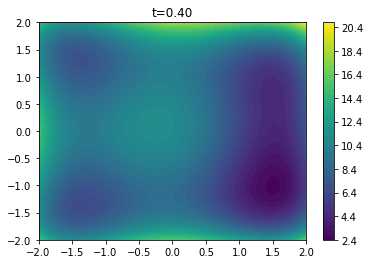

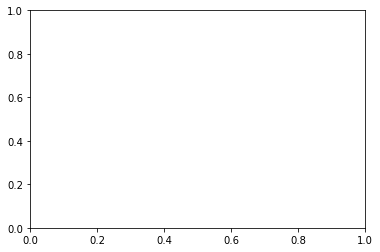

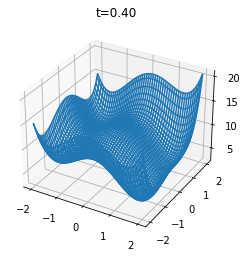

(<Axes3DSubplot:title={'center':'t=0.40'}>,
 <mpl_toolkits.mplot3d.art3d.Line3DCollection at 0x7fa5918008b0>)

In [123]:
#to see just a certain point in time, t,  use show_potential(t)
# the surface argument determines if we see a wireframe or a contour plot.
"""What's the middle one for?"""
erase_sys.show_potential(0.4)
erase_sys.show_potential(0.4, surface=True)

In [124]:
# you can pull out forces, the potential, or the energy given a set of coordiantes and a time 
# note the total energy assumes a kinetic energy given by 1/2 mv^2, it takes in a mass argument 
# but the default is unit mass

potentials=erase_sys.get_potential(coords_2D, .7)
print('potentials for trials 11-15:', potentials[10:15])

energy = erase_sys.get_energy(coords_2D, 0)
print('KE+U for the same coordinates',energy[10:15])

# the output for forces is in the form (N,D): N sets of D forces
forces=erase_sys.get_external_force(coords_2D, .5)
print('forces for trial 4:{}'.format(forces[3]))
print('forces in the "y" direction for all trials 1-4:', forces[0:4,1])

potentials for trials 11-15: [13.28039937 14.33576893 12.57875261 11.82890783 13.00032024]
KE+U for the same coordinates [16.70979714 17.61035968 16.05684097 14.86951601 16.08296499]
forces for trial 4:[5.61181292 0.15301626]
forces in the "y" direction for all trials 1-4: [ 0.80238637 -0.81870159  0.34677073  0.15301626]


# Creating new potentials

##### Lets say we want to make a new kind of potential, say a 2 dimensional potential that is an exponential well at (x,y)=0

$$ V= - e^{-\frac{ax^2+by^2}{T}} $$

##### We have 3 parameters to deal with (a, b and T). All we need to do is make a function to give us the potential and the force
##### It is good practice to stick to the following docstring format when making the potential function.
##### It makes it easier to collaborate with others/yourself.

In [125]:
from numpy import exp as exp

def exp_well_pot(x, y, params):
    '''
    2D potential, an exponential well centered at (0,0)
    with a variable aspect ratio
    
    Parameters
    ----------
    x,y : ndarray of dimension [N_coord,]
        these are lists of the x and y values where we want to find the potential
    params: list [a,b,T]
        a,b : the scale at which the x and y directions change the value of the potential
        T : the overall 'temperature' scale: affects both x and y directions equally
        
    Returns
    -------
    the value of the potential at locations x,y with the given params
    '''
    a, b, T = params
    return(-exp(-(a*x**2+b*y**2)/T))

def exp_well_force(x, y, params):
    '''
    See the exp_well_pot function, it has the same input format
    '''
    a, b, T = params
    dx= 2*a*x*exp(-(a*x**2+b*y**2)/T)/T
    dy= 2*a*y*exp(-(a*x**2+b*y**2)/T)/T
    return(-dx,-dy)
   

In [126]:
# definine a new potential class takes a potential function and a force function as inputs.
# also you need to put in the number of parameters (3 here) and the number of dimensions (2 here)
exp_well = Potential(exp_well_pot,exp_well_force,3,2)  

# we can go ahead and look at it now by sending it through a System using Potential.trivial_protocol
# this just sets all parameters to 1(or default values if they exist) and the time window from 0 to 1

# the default parameters can be redefined when you instance a Potential class 
# by passing a list of the default parameters
# such as exp_well=Potential(exp_well_pot, exp_well_force, 3, 2, default_params=(3,8,.1))

# additionally, you can set a relevant domain: range of coordiantes you expect to care about:
# domain = [[-3,-2], [3,2]] would set the x and y domains to be [-3,3] and [-2,2], respectively 
# exp_well=Potential(exp_well_pot, exp_well_force, 3, 2, relevant_domain=domain)

trivial_system = System(exp_well.trivial_protocol(),exp_well)





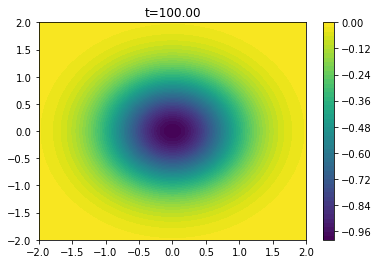

(<AxesSubplot:title={'center':'t=100.00'}>,
 <matplotlib.contour.QuadContourSet at 0x7fa5926356a0>)

In [127]:
trivial_system.show_potential(100)

# Creating new protocols

In [128]:
# Generally,  we want make a protocol that will operate on the potential. 
# This protocol will go from t=0 to t=.6
t=[0,.6]
#we'll interpolate from a totally symmetric well (a=1,b=1,T=1) to a deformed well at the same T (a=.5,b=2,T=1) 
params=[[1,.2],[1,3],[1,1]]

#now, we make a protocol. WSP is short for well_stetch_protocol
WSP=Protocol(t,params)



In [129]:
#Finally, we apply the well stretch protocol to the exp_well potential
well_stretch=System(WSP,exp_well)

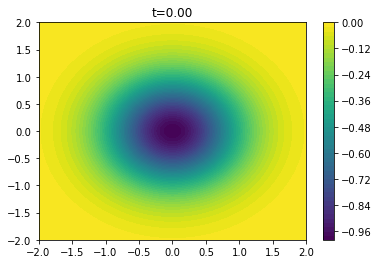

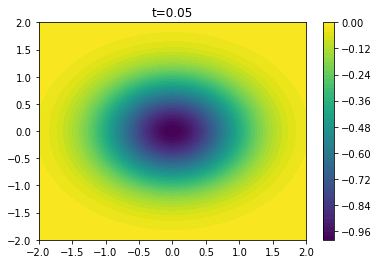

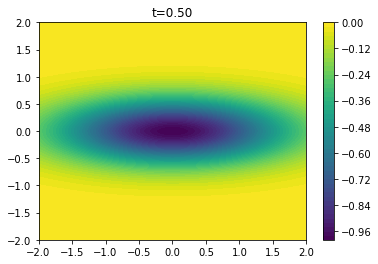

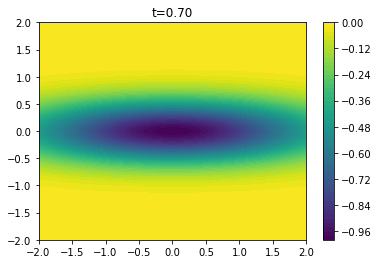

(<AxesSubplot:title={'center':'t=0.70'}>,
 <matplotlib.contour.QuadContourSet at 0x7fa591eeb670>)

In [130]:
#and just to make sure it worked as expected, lets plot it:
well_stretch.show_potential(0)

well_stretch.show_potential(.05)

#you can specify a manual domain, if you want.
well_stretch.show_potential(.5)

well_stretch.show_potential(.7)


# Editing Protocols

In [131]:
#lets say we want to make a compound protocol that stretches the well and then unstretches it
#here we can call the reverse method of protocols, which reverses all parameters but NOT the times.

# it is functionally equivalent to  redefining the input params from ((a,b),(c,d),(e,f)) to ((b,a),(d,c),(f,e))

#first make a copy of the original protocol
WSP_rev=WSP.copy()
#then call the reverse method to reverse the parameters for the copy
WSP_rev.reverse()


In [132]:
#note that the times will conflict if we try to concatenate onto the
#original protocol because they both operate between t=0 and t=.6
#we should get an error message if we try
SAR_prot=Compound_Protocol((WSP,WSP_rev))

AssertionError: protocol times overlap

In [ ]:
#so we need to time shift the second one to start at some point after t=.6
#use Protocol.time_shift for this:

print(f"Before the shift, WSP_rev initial time is: {WSP_rev.t_i}, WSP_rev final time is: {WSP_rev.t_f}")

WSP_rev.time_shift(WSP.t_f)

print(f"After the shift, WSP_rev initial time is: {WSP_rev.t_i}, WSP_rev final time is: {WSP_rev.t_f}")


In [ ]:
#If we do this several times in a row, it will keep shifting the protocol times. 
print("WSP_rev initial time is:",WSP_rev.t_i,"WSP_rev final time is:",WSP_rev.t_f)
WSP_rev.time_shift(WSP.t_f)
print("initial time is:",WSP_rev.t_i,"final time is:",WSP_rev.t_f)

In [ ]:
# Lets make a compound protocol, to see what happens in this case. 
# Note that we don't need to time order the substages, the class initialization will do that for us

SAR_prot=Compound_Protocol((WSP_rev,WSP))
SAR_prot.show_substage_times()

# it's okay that there is some dead space between the protocol steps, the protocol assumes that to mean that 
# we keep the parameters constant in the meantime.



In [ ]:
#now we can apply the compound protocol made of stretch and unstretch:
stretch_and_rev=System(SAR_prot,exp_well)

In [ ]:
%%capture
# now we can see the whole protocol:
# well put a manual domain in the animate_protocol method, because if we dont the well 
# will stretch far out of our default domain of -2,2
ani=stretch_and_rev.animate_protocol(surface=False, manual_domain = [[-3, -3], [3,3]] )
HTML(ani.to_jshtml(fps=10))
#note that parameters are held fixed between the explicit substages to fill in the gaps

In [ ]:
ani

In [ ]:
# we can also edit protocols that we have already made with the Protocol.change_param method
# lets say we want the first parameter in our reverse process to actually go from .2 to 3 instead of down to 1

print(WSP_rev.params)
#we now call the change_param method, which takes in which parameters you want to change 
#and new initial and final values
WSP_rev.change_params(1,(.2,3))

print(WSP_rev.params)


In [ ]:
# if we want to make the WSP_rev stage of the protocol take longer
# we can use Protocol.time_stretch for that
print(WSP_rev.t_i,WSP_rev.t_f)
WSP_rev.time_stretch(3)
print(WSP_rev.t_i,WSP_rev.t_f)

In [ ]:
%%capture
SAR_slow = Compound_Protocol((WSP,WSP_rev))
SAR_slow_sys=System(SAR_slow, exp_well)

ani=SAR_slow_sys.animate_protocol(surface=False)
HTML(ani.to_jshtml(fps=10))

In [ ]:
ani

In [ ]:
#the normalize method will always set the overall time interval to be 1 time unit while keeping the 
# relative lengths equal
"""Why no differences between the two?"""
print('before normlize')
SAR_slow.time_stretch(3)
SAR_slow.show_substage_times()

SAR_slow.normalize()

print('after normalize:')
SAR_slow.show_substage_times()

# Higher Dimensional Potentials


##### 5 dimensional spherical containment with a hard edge :

$$ V= 0 \quad\text{for} \quad \sqrt{x_i x^i} > r $$
$$ V=V_0  \quad\text{for}\quad \sqrt{x_i x^i} < r$$





In [ ]:
def five_d_sphere(x1, x2, x3, x4, x5, params):
    '''
    5D hard sphere 'well'
    
    Parameters
    ----------
    x1, x2, x3, x4, x5: ndarray of dimension [N_coords,]
        these are your coordinates
    params: list/tuple (1,2) [r, V0]:
        1: r, the radius of the sphere
        2: V0, the magnitude of the potential when you are inside the sphere
    
    Returns
    -------
    the value of the potential at the coordinates, for the params
    '''
    r, V0=params
    pos=x1, x2, x3, x4, x5
    distance=np.sqrt(np.sum(np.square(pos), axis=0))
    
    return  V0 * (1 - np.sign(distance - r)) / 2

def five_d_sphere_f(x1, x2, x3, x4, x5, params):
    '''
    See the five_d_sphere function, it has the same input format
    '''
    r,V0 = params
    pos = x1, x2, x3, x4, x5
    
    return(0, 0)

#note that the way it is set up makes really high dimensional potentials kind of annoying to write. 
#this can be changed if there is reason to.

#first we instance a Potential
# Potential(potential functions, force functions, number of parameters, number of dimensions)
fds = Potential(five_d_sphere, five_d_sphere_f, 2, 5)

#then we make a Protocol
fds_times=(0,1)
fds_params=((.5,1.8),(-1,0))
fds_prot = Protocol(fds_times,fds_params)

#then use a System to apply fdp_prot to the fds potential
fds_sys=System(fds_prot,fds)

In [ ]:
# when you call show_potential, we now take a 2-d slice of the potential, 
# sets all other coordinates to zero by default, and automatically chooses the first 2 coordinates

# below is a slice that shows what happens at 0=x2=x4=x5, and varying x1 and x3

In [ ]:
fds_sys.show_potential(.5,surface=True, axis1=1,axis2=3)

In [ ]:
# we can also set the slice values
slice_vals=(0,.6,0,.6,.2)
# here it will set x3=0, x4=.6, and x5=.2 while varying x1 and x2 (defaul axes)
fds_sys.show_potential(.5,surface=True, slice_values=slice_vals)

In [ ]:
%%capture
# again, we can animate. default axis and slice is the same as show_potential
# mesh control the numbe of points we calcualte the potential at
ani = fds_sys.animate_protocol(surface=True, mesh=30, axis1=2, axis2=3)
HTML(ani.to_jshtml(fps=10))

In [ ]:
ani

# Bonus practice

#### ODV is a built in potential for testing purposes, go ahead and try to apply a protocol to it to see if your familiar enough with the package

In [ ]:
odv.info()

In [133]:
odv.info(verbose=True)


    A simple 1D potential, for testing one dimensional systems
    its just an absolute value.

    Parameters
    ----------
    x: the coordinates
    params: (1,2)
        1: the slope
        2: zero point

    Returns
    -------
    the value of the potential at location x with the given params
    


In [134]:
#make a protocol

#EXAMPLE:
    #p1=[3,.1]
    #p2=[-.5,.5]
    #t=[0,1]
    #odv_prot = Protocol[t, [p1,p2]] 


In [135]:
# make a system
# EXAMPLE:
#    odv_sys=System(odv_prot, odv)

# Working With built-in potentials

In [136]:
#lets say we want to implement a lengthy protocol without making a bunch of proper substages. The function for that is sequentiual_protocol
#often you want most parameters to stay the same, and only one or two change at a time. this is useful for that case, since you only define
#the changing pieces of the protocol
from protocol_designer.protocol import sequential_protocol

ModuleNotFoundError: No module named 'protocol_designer'

In [137]:
sequential_protocol?

Object `sequential_protocol` not found.


In [138]:
# as an example, let's make Alec's version of the Szilard Engine. This operates on the coupled Duffing_2D potential
from sus.library.potentials import duffing_2D

#out of the 7 possible parameters in this potential, 3 of them are held fixed at the default value for
#the potential (can be accessed with Potential.default_params, if its not defined the default will set all
# parameters to 0)
duffing_2D.default_params

(1.0, 1.0, -1.0, -1.0, 0, 0, 0)

In [139]:
# in this version of szilards engine, we keep everything fixed except for the 3rd, 4th, 6th, and 7th parameters.
# it is a 12 step protocol, so there are 13 places we need to define the changing parameters including
# the start point and the end point

p3 = (-1, -1, -1, -1, -1, 0, 0, -1, -1, -1, -1, -1, -1)
p4 = (-1, 0, 0, -1, -1, -1, -1, -1, -1, 0, 0, -1, -1)
p6 = (0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0)
p7 = (0, 0, -1, -1, 0, -1, -1, 0, 0, 0, 0, 0, 0)

# we prepare a list of the which parameters will change, and also their values at each substage time
which=(3,4,6,7)
non_triv_param=(p3,p4,p6,p7)
# there are 12 steps
NS=12
#and 7 parameters
NP=7

In [140]:
#then we create the Compound Protocol (note that default_params is optional, and defaults will be 0 without it)
szilard_prot_1 = sequential_protocol(NS, NP, which, non_triv_param, initial_params=duffing_2D.default_params )

#and apply it to the duffing potential
szil_sys=System(szilard_prot_1, duffing_2D)

NameError: name 'sequential_protocol' is not defined

In [141]:
%%capture
ani=szil_sys.animate_protocol(frames=100, n_contours=30, surface=False, manual_domain=[[-1,-1],[1,1]])
HTML(ani.to_jshtml(fps=9))

NameError: name 'szil_sys' is not defined

In [142]:
ani

In [143]:
# note that the function automatically makes NS substages of equal length between t=0 and t=1
# if you want to customize the times, then you can pass a list of length NS+1 to define
# the substage times:
t_list=(0, .5, .75, 1, 1.5, 2, 2.2, 2.8, 3, 4, 5, 6, 6.3)
szilard_prot_2 = sequential_protocol(NS, NP, which, non_triv_param, times=t_list, initial_params=duffing_2D.default_params)

NameError: name 'sequential_protocol' is not defined

In [144]:
szilard_prot_2.show_substage_times()

NameError: name 'szilard_prot_2' is not defined

# Working With Built In Systems

In [145]:
from sus.library.szilard_protocols import ew2_szilard as exp_szilard
system = exp_szilard

In [146]:
# the above is a different implementation of szilards engine, using exponentially localized wells

In [147]:
system.potential.info(verbose=True)


    4 wells in 2D, using a exponentially localized wells

    Parameters
    ----------
    x: ndarray of dimension [N,]
        the x coordinates for N positions
    y: ndarray of dimension [N,]
        the y coordinates for N positions
    params: list/tuple (1, 2, 3, ..., 16)

    1,2,3,4: barrier heights b/w L0:L1, R0:R1, L0:R0, L1:R1                         (0,1)
    5,6,7,8: well depths L0,L1,R0,R1 wells                                          (absolute)
    (9,10),(11,12),(13,14),(15,16): (x,y) coordiantes of the L0,L1,R0,R1 wells      (absolute)

    scaled_parameters: True or False
        if True will scale the parameters to be functionally meaningful
        i.e. setting parameter 1 to 0 means that the barrier is dropped to its lowest value
        and setting it to 1 means that it is at its highers value
        if False, parameters are taken to be the actual inputs without the extra layer or functionalizing them
    Returns
    -------
    the value of the potential at l

In [148]:
#the default locations of the wells are at locations (-1,-1), (1,1), etc... (parameters 9-16)
system.potential.default_params

(1, 1, 1, 1, 1, 1, 1, 1, -1, -1, -1, 1, 1, -1, 1, 1)

In [149]:
# lets say we want to make them all be closer to the origin, we can edit the protocol.parameters arttribute
# but it is a little tricky because this is a many-substage protocol,
# so well need to edit the parameters for each substage

# substages are stored in the Compound_Protocol.protocols

# one way to do this is to loop through each protocol in protocols and use the change_param method

In [150]:
r=.6
new_params= r* system.protocol.params[8:16]
for item in system.protocol.protocols:
    item.change_params((9,10,11,12,13,14,15,16),new_params)

#if we wanted to do this in a non destructive way, we could first make a new copy
#    new_sys = system.copy()
#    and then operate on new_sys


In [151]:
%%capture
ani=system.animate_protocol(n_contours=20, surface=True, manual_domain=[[-1,-1],[1,1]])
HTML(ani.to_jshtml(fps=8))

In [152]:
ani

In [153]:
#this tutorial has gotten prety long, so maybe we'll stop here.

In [157]:
source_path = os.path.expanduser('~/Project/source/')
sim_path = os.path.dirname(source_path + "simtools/infoenginessims/")
sys.path.append(sim_path)

from simulation import Simulation

In [160]:
Simulation.run?